### adding libraries


In [62]:
## adding libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import nbformat
from sklearn.compose import ColumnTransformer
import seaborn as sns
# import standard scaler and train test split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.preprocessing import OneHotEncoder 
from sklearn.preprocessing import LabelEncoder
from xgboost import XGBClassifier as xgb
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
import lightgbm as lgb
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_curve, auc
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering



### reading provided dataset


In [4]:
### reading provided dataset
customer_df = pd.read_csv('../../data/raw/term-deposit-marketing-2020.csv')

In [5]:
customer_df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,no


In [6]:
customer_df.describe()  

,age,balance,day,duration,campaign
count,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000
mean,40.544600,1274.277550,16.017225,254.824300,2.882175
std,9.641776,2903.769716,8.278127,259.366498,3.239051
min,19.000000,-8019.000000,1.000000,0.000000,1.000000
25%,33.000000,54.000000,8.000000,100.000000,1.000000
50%,39.000000,407.000000,17.000000,175.000000,2.000000
75%,48.000000,1319.000000,21.000000,313.000000,3.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000


In [7]:

customer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        40000 non-null  int64 
 1   job        40000 non-null  object
 2   marital    40000 non-null  object
 3   education  40000 non-null  object
 4   default    40000 non-null  object
 5   balance    40000 non-null  int64 
 6   housing    40000 non-null  object
 7   loan       40000 non-null  object
 8   contact    40000 non-null  object
 9   day        40000 non-null  int64 
 10  month      40000 non-null  object
 11  duration   40000 non-null  int64 
 12  campaign   40000 non-null  int64 
 13  y          40000 non-null  object
dtypes: int64(5), object(9)
memory usage: 4.3+ MB


### day needs to be categorical


In [8]:
## day needs to be categorical
customer_df['day'] = customer_df['day'].astype('object')

### dropping the output variable from the features dataframe


In [9]:
input_features = customer_df.drop('y', axis=1)
target_variable = customer_df['y']  # assuming 'y' is the target variable

### Identify numerical and categorical features


In [10]:
# Identify numerical and categorical features
numerical_features = input_features.select_dtypes(include=[np.number]).columns.tolist()
categorical_features = input_features.select_dtypes(include=['object']).columns.tolist()

In [11]:
print("Numerical Features:", numerical_features)
print("Categorical Features:", categorical_features)

Numerical Features: ['age', 'balance', 'duration', 'campaign']
Categorical Features: ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'day', 'month']


### features having unknown values


In [12]:
# features having unknown values
categorical_features_with_unknown = []
for col in categorical_features:
    unknown_count = (input_features[col] == 'unknown').sum()
    if unknown_count > 0:
        print(f"Column '{col}' has {unknown_count} 'unknown' values.")
        categorical_features_with_unknown.append(col)

Column 'job' has 235 'unknown' values.
Column 'education' has 1531 'unknown' values.
Column 'contact' has 12765 'unknown' values.


### setting "y" to binary


In [13]:
## setting y to binary
target_variable = target_variable.map({'yes': 1, 'no': 0})

In [14]:
customer_df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'y'],
      dtype='object')

### checking distribution of y and other features against y - plotting using plotly


In [15]:
### checking distribution of y and other features against y - plotting using plotly
fig = px.histogram(customer_df, x='y', title='Distribution of Target Variable(y)')
fig.show()
fig.write_image('../../reports/figures/distribution_of_target_variable.png')
fig = px.histogram(customer_df, x='job', color='y', barmode='group', title='Job vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/job_vs_subscription_status.png')
fig = px.histogram(customer_df, x='marital', color='y', barmode='group', title='Marital Status vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/marital_status_vs_subscription_status.png')
fig = px.histogram(customer_df, x='education', color='y', barmode='group', title='Education vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/education_vs_subscription_status.png')
fig = px.histogram(customer_df, x='default', color='y', barmode='group', title='default vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/default_vs_subscription_status.png')
fig = px.histogram(customer_df, x='balance', color='y', barmode='group', title='balance vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/balance_vs_subscription_status.png')
fig = px.histogram(customer_df, x='housing', color='y', barmode='group', title='housing vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/housing_vs_subscription_status.png')
fig = px.histogram(customer_df, x='loan', color='y', barmode='group', title='loan vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/loan_vs_subscription_status.png')   
fig = px.histogram(customer_df, x='contact', color='y', barmode='group', title='Contact Type vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/contact_type_vs_subscription_status.png')
fig = px.histogram(customer_df, x='month', color='y', barmode='group', title='Month vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/month_vs_subscription_status.png')
fig = px.histogram(customer_df, x='day', color='y', barmode='group', title='day vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/day_vs_subscription_status.png')
fig = px.histogram(customer_df, x='duration', color='y', barmode='group', title='duration vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/duration_vs_subscription_status.png')
fig = px.histogram(customer_df, x='campaign', color='y', barmode='group', title='campaign vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/campaign_vs_subscription_status.png')
fig = px.histogram(customer_df, x='age', color='y', barmode='group', title='Age vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/age_vs_subscription_status.png')



### customers likely to have subscription:
- people in the age group between 30 - 40
- month of May seems to have highest subscription
- people who are married 
- people who have secondary level of education
- who are run with campaign type 1 
- duration of call plays an important role
- customers contacted via cellular 

### use plotly to create interactive visualizations


In [ ]:
# use plotly to create interactive visualizations
for col in input_features.columns:
    fig = px.histogram(input_features, x=col, title=f'Distribution of {col}', marginal="box")
    fig.show()
    fig.write_image(f'../../reports/figures/distribution_of_{col}.png')

### percentage distribution


In [17]:
# percentage distribution
total = len(target_variable)
percentage_yes = (target_variable.sum() / total) * 100
percentage_no = 100 - percentage_yes
print(f"Total samples: {total}")
print(f"Number of 'yes': {target_variable.sum()}")
print(f"Number of 'no': {total - target_variable.sum()}")
print(f"Percentage of 'yes': {percentage_yes:.2f}%")
print(f"Percentage of 'no': {percentage_no:.2f}%")

Total samples: 40000
Number of 'yes': 2896
Number of 'no': 37104
Percentage of 'yes': 7.24%
Percentage of 'no': 92.76%


### calculating class weights to handle class imbalance


In [18]:
## calculating class weights to handle class imbalance
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(target_variable), y=target_variable)
class_weight_dict = {i : class_weights[i] for i in range(len(class_weights))}
print("Class Weights:", class_weight_dict)

Class Weights: {0: np.float64(0.5390254420008624), 1: np.float64(6.906077348066298)}


-  Graph shows that the dataset is imbalanced with more customers not subscribing to term deposit than subscribing.
-  This imbalance needs to be addressed during model training using techniques like oversampling, undersampling,

In [19]:
customer_df[categorical_features].describe()

,job,marital,education,default,housing,loan,contact,day,month
count,40000,40000,40000,40000,40000,40000,40000,40000,40000
unique,12,3,4,2,2,2,3,31,11
top,blue-collar,married,secondary,no,yes,no,cellular,20,may
freq,9383,24386,20993,39191,24031,33070,24914,2655,13532


In [20]:
customer_df[categorical_features].nunique()

job          12
marital       3
education     4
default       2
housing       2
loan          2
contact       3
day          31
month        11
dtype: int64

### Getting counts for each month in the input features data frame


In [21]:
monthname = ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']
for month in monthname:
    print(f"{month}: {input_features[input_features['month'] == month]['month'].value_counts().get(month, 0)}")

jan: 1176
feb: 2296
mar: 258
apr: 2718
may: 13532
jun: 4734
jul: 6380
aug: 5215
sep: 0
oct: 80
nov: 3598
dec: 13


### there are no entries for september


In [22]:
## there are no entries for september
input_features['month'].unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'jan', 'feb',
       'mar', 'apr'], dtype=object)

#### **Feature engineering**

In [23]:
#### **Feature engineering**
# converting day to week
input_features['week'] = input_features['day'].apply(lambda x: (int(x)-1)//7 + 1)
input_features['week'].value_counts()


week
3    12887
2     8880
1     8423
4     6162
5     3648
Name: count, dtype: int64

### converting month to quarter


In [24]:
# converting month to quarter
monthname = ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']

# normalize month values and map to quarter
input_features['month_norm'] = input_features['month'].astype(str).str.lower()

def month_to_quarter(m):
	try:
		return (monthname.index(m) // 3) + 1
	except ValueError:
		return np.nan

input_features['quarter'] = input_features['month_norm'].map(month_to_quarter).astype('Int64')
input_features.drop(columns=['month_norm'], inplace=True)

input_features['quarter'].value_counts(dropna=False)


quarter
2    20984
3    11595
1     3730
4     3691
Name: count, dtype: Int64

### add week and quarter to categorical features


In [25]:
### add week and quarter to categorical features
categorical_features.append('week')
categorical_features.append('quarter')

### creating new features is_high_balance and loan_count


In [26]:
# creating new features is_high_balance and loan_count
is_high_balance = customer_df['balance'] > customer_df['balance'].median()
print(is_high_balance)
loan_count = customer_df['housing'].map({'yes':1, 'no':0}) + customer_df['loan'].map({'yes':1, 'no':0})
print(loan_count)

0         True
1        False
2        False
3         True
4        False
         ...  
39995    False
39996     True
39997    False
39998     True
39999     True
Name: balance, Length: 40000, dtype: bool
0        1
1        1
2        2
3        1
4        0
        ..
39995    0
39996    0
39997    0
39998    0
39999    1
Length: 40000, dtype: int64


### adding loan_count and is_high_balance to input features


In [27]:
## adding loan_count and is_high_balance to input features
input_features['is_high_balance'] = is_high_balance.astype(int)
input_features['loan_count'] = loan_count

### adding campaign features


In [28]:
## adding campaign features
input_features['campaign_intensity'] = input_features['duration'] / (input_features['campaign'] + 1)
contacted_multiple_times = input_features['campaign'] > 1
input_features['contacted_multiple_times'] = contacted_multiple_times.astype(int)
is_last_call_long = input_features['duration'] > input_features['duration'].median()
input_features['is_last_call_long'] = is_last_call_long.astype(int)
#input_features.append('contacted_multiple_times')
#input_features['campaign_intensity'].append('campaign_intensity')
#input_features['is_last_call_long'].append('is_last_call_long')

### adding age binning


In [29]:
## adding age binning
age_bins = [0, 18, 30, 40, 50, 60, 70, 80, 100]
age_labels = ['<18', '18-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+']
input_features['age_group'] = pd.cut(input_features['age'], bins=age_bins, labels=age_labels, right=False)
#categorical_features.append('age_group')

In [30]:
input_features.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'week',
       'quarter', 'is_high_balance', 'loan_count', 'campaign_intensity',
       'contacted_multiple_times', 'is_last_call_long', 'age_group'],
      dtype='object')

### merge input features and target variable for plotting


In [31]:
# merge input features and target variable for plotting
customer_df_updated = pd.concat([input_features, target_variable], axis=1)

### weeks vs subscription status


In [32]:
### weeks vs subscription status
fig = px.histogram(customer_df_updated, x='week', color='y', barmode='group', title='Week vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/week_vs_subscription_status.png')
### quarters vs subscription status
fig = px.histogram(customer_df_updated, x='quarter', color='y', barmode='group', title='Quarter vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/quarter_vs_subscription_status_featured.png')
### campaign_intensity vs subscription status
fig = px.histogram(customer_df_updated, x='campaign_intensity', color='y', barmode='group', title='Campaign Intensity vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/campaign_intensity_vs_subscription_status_featured.png')
### loan_count vs subscription status
fig = px.histogram(customer_df_updated, x='loan_count', color='y', barmode='group', title='Loan Count vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/loan_count_vs_subscription_status_featured.png')
### age_group vs subscription status
fig = px.histogram(customer_df_updated, x='age_group', color='y', barmode='group', title='Age Group vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/age_group_vs_subscription_status_featured.png')


### few important things to note about these new features with regards to customer subscription
- week 3 of month & quarter 2 seems to have highest number of subscriptions.
- people having one loan tend to get subscription.
- campaign intensity plays an important role in customer subscriptions.
- age group 30 - 39 have the highest tendency to get the subscription. 

### Code explanation


In [33]:
input_features.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,...,duration,campaign,week,quarter,is_high_balance,loan_count,campaign_intensity,contacted_multiple_times,is_last_call_long,age_group
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,...,261,1,1,2,1,1,130.5,0,1,50-59
1,44,technician,single,secondary,no,29,yes,no,unknown,5,...,151,1,1,2,0,1,75.5,0,0,40-49
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,...,76,1,1,2,0,2,38.0,0,0,30-39
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,...,92,1,1,2,1,1,46.0,0,0,40-49
4,33,unknown,single,unknown,no,1,no,no,unknown,5,...,198,1,1,2,0,0,99.0,0,1,30-39


### Code explanation


In [34]:
month_map = {'jan':1,'feb':2,'mar':3,'apr':4,'may':5,'jun':6,'jul':7,'aug':8,'sep':9,'oct':10,'nov':11,'dec':12}
input_features['month_num'] = input_features['month'].map(month_map)
input_features['is_quarter_end'] = input_features['month_num'].isin([3,6,9,12]).astype(int)


### customer segmentation features


In [35]:
### customer segmentation features
#age_group already added

## has any loan
has_loan = ((input_features['housing'] == 'yes') | (input_features['loan'] == 'yes')).astype(int)

## education & job
education_job = input_features['education'] + "_" + input_features['job']

### adding new features to input_features


In [36]:
## adding new features to input_features
#input_features['age_group'] = age_group
input_features['has_loan'] = has_loan
input_features['education_job'] = education_job
input_features.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'week',
       'quarter', 'is_high_balance', 'loan_count', 'campaign_intensity',
       'contacted_multiple_times', 'is_last_call_long', 'age_group',
       'month_num', 'is_quarter_end', 'has_loan', 'education_job'],
      dtype='object')

### separating features again


In [37]:
## separating features again
numerical_features_updated = input_features.select_dtypes(include=[np.number]).columns.tolist()
categorical_features_updated = input_features.select_dtypes(include=['object', 'category']).columns.tolist()


### setting up preprocessors using standard scaler for numeric columns and onehotencoder for categorical columns

In [ ]:
## setting up preprocessors
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
binary_transformer = LabelEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features_updated),
        ('cat', categorical_transformer, categorical_features_updated)
        
    ]
)

### TRAIN / VAL / TEST SPLIT  (70 / 15 / 15)


In [39]:
# TRAIN / VAL / TEST SPLIT  (70 / 15 / 15)
X_train, X_temp, y_train, y_temp = train_test_split(
    input_features, target_variable, test_size=0.30, random_state=42, stratify=target_variable
)

X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.50, random_state=42, stratify=y_temp
)


### percentage distribution


In [40]:
# percentage distribution
total = len(target_variable)
# class weight of yes
cw_yes = total / (2 * target_variable.sum())
print(f"Class weight for 'yes': {cw_yes:.2f}")
# class weight of no
cw_no = total / (2 * (total - target_variable.sum()))
print(f"Class weight for 'no': {cw_no:.2f}")

Class weight for 'yes': 6.91
Class weight for 'no': 0.54


### train logistic regression model


Logistic regression Classifier Results:
Accuracy score: 0.9076666666666666
Precision score: 0.42287917737789205
Recall score: 0.7580645161290323
F1 score: 0.5429042904290429
classification report:
               precision    recall  f1-score   support

           0       0.98      0.92      0.95      5566
           1       0.42      0.76      0.54       434

    accuracy                           0.91      6000
   macro avg       0.70      0.84      0.75      6000
weighted avg       0.94      0.91      0.92      6000



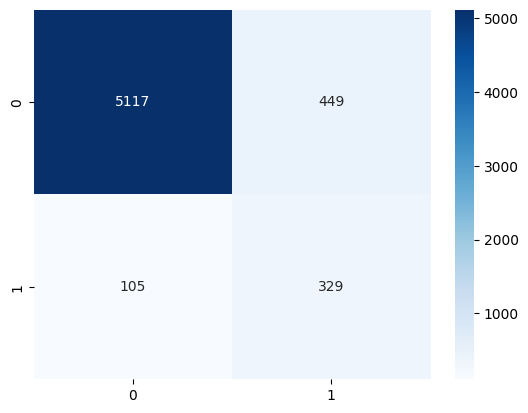

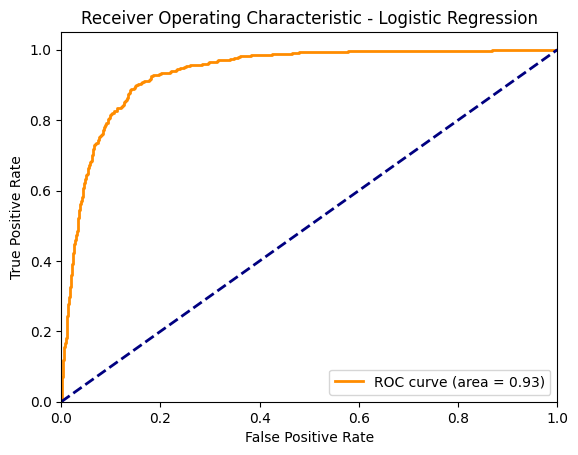

In [41]:
### train logistic regression model

# rebuild preprocessor to reflect the cleaned categorical_features
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features_updated),
        ('cat', categorical_transformer, categorical_features_updated)
    ]
)
class_weight_dict = {0: 1.0, 1: 6.0}  # keeping class weight of no as 1.0
model_lr = LogisticRegression(class_weight=class_weight_dict, max_iter=1000, random_state=42)
pipeline_lr = Pipeline(steps=[('preprocessor', preprocessor),
                              ('classifier', model_lr)])
pipeline_lr.fit(X_train, y_train)
y_pred_lr = pipeline_lr.predict(X_test)
print("Logistic regression Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_lr))
print('Precision score:', precision_score(y_test, y_pred_lr))
print('Recall score:', recall_score(y_test, y_pred_lr))
print('F1 score:', f1_score(y_test, y_pred_lr))
print('classification report:\n', classification_report(y_test, y_pred_lr))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lr), annot=True, fmt='d', cmap='Blues')
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_lr = pipeline_lr.predict_proba(X_test)[:, 1]
fpr_lr, tpr_lr, _ = roc_curve(y_test, y_pred_proba_lr)
roc_auc_lr = auc(fpr_lr, tpr_lr)
plt.figure()
plt.plot(fpr_lr, tpr_lr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_lr)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Logistic Regression')
plt.legend(loc="lower right")
plt.show()


### using knn classifier


KNN Classifier Results:
Accuracy score: 0.9303333333333333
Precision score 0.532520325203252
Recall score 0.30184331797235026
Confusion Matrix:
 [[5451  115]
 [ 303  131]]
classification report:
               precision    recall  f1-score   support

           0       0.95      0.98      0.96      5566
           1       0.53      0.30      0.39       434

    accuracy                           0.93      6000
   macro avg       0.74      0.64      0.67      6000
weighted avg       0.92      0.93      0.92      6000



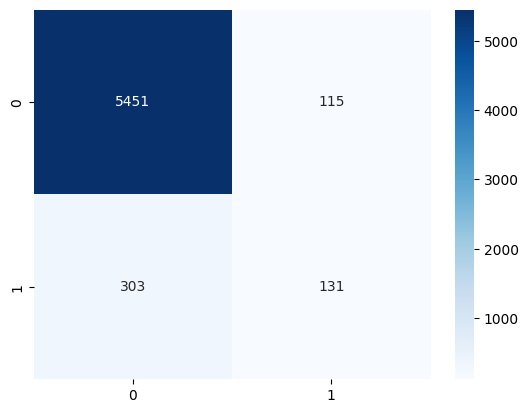

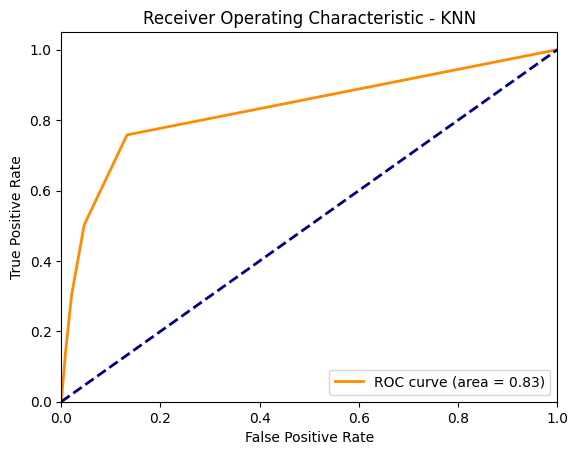

In [42]:
### using knn classifier
class_weight_dict = {0: 1.0, 1: 6} 
weight_val ='6'





model_knn = KNeighborsClassifier(weights='uniform', n_neighbors=5)
pipeline_knn = Pipeline(steps=[('preprocessor', preprocessor),
                              ('classifier', model_knn)])
pipeline_knn.fit(X_train, y_train)
y_pred_knn = pipeline_knn.predict(X_test)
print("KNN Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_knn))
print('Precision score', precision_score(y_test, y_pred_knn))
print('Recall score', recall_score(y_test, y_pred_knn))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_knn))
print('classification report:\n', classification_report(y_test, y_pred_knn))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_knn), annot=True, fmt='d', cmap='Blues')
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_knn = pipeline_knn.predict_proba(X_test)[:, 1]
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_pred_proba_knn)
roc_auc_knn = auc(fpr_knn, tpr_knn)
plt.figure()
plt.plot(fpr_knn, tpr_knn, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_knn)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - KNN')
plt.legend(loc="lower right")
plt.show()


### train Random Forest Classifier


Random Forest Classifier Results:
Accuracy score: 0.9351666666666667
Precision score 0.6119402985074627
Recall score 0.2834101382488479
Confusion Matrix:
 [[5488   78]
 [ 311  123]]
classification report:
               precision    recall  f1-score   support

           0       0.95      0.99      0.97      5566
           1       0.61      0.28      0.39       434

    accuracy                           0.94      6000
   macro avg       0.78      0.63      0.68      6000
weighted avg       0.92      0.94      0.92      6000



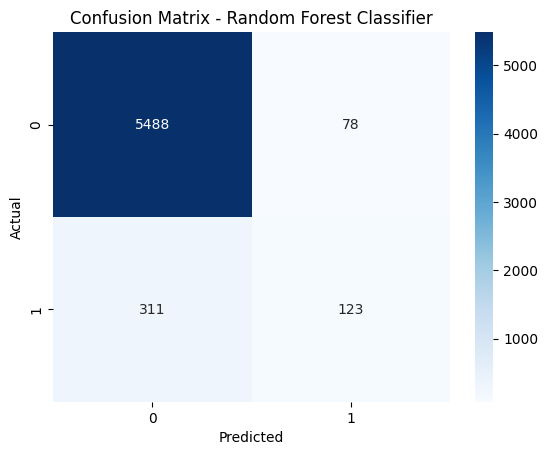

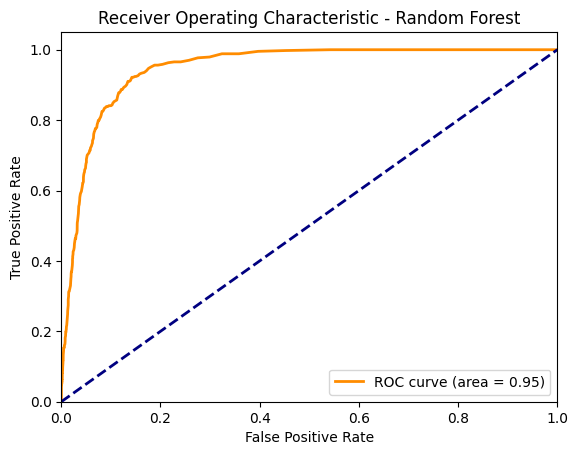

In [43]:
## train Random Forest Classifier
class_weight_dict = {0: 1.0, 1: 5}  # keeping class weight of no as 1.0
model_rf = RandomForestClassifier(n_estimators=300, random_state=42, class_weight=class_weight_dict)
pipeline_rf = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_rf)])
### predict the test set results
pipeline_rf.fit (X_train, y_train)
y_pred_rf = pipeline_rf.predict(X_test)
print("Random Forest Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_rf))
print('Precision score', precision_score(y_test, y_pred_rf))
print('Recall score', recall_score(y_test, y_pred_rf))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_rf))
print('classification report:\n', classification_report(y_test, y_pred_rf))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_rf), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - Random Forest Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_rf = pipeline_rf.predict_proba(X_test)[:, 1]
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_proba_rf)
roc_auc_rf = auc(fpr_rf, tpr_rf)
plt.figure()
plt.plot(fpr_rf, tpr_rf, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_rf)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Random Forest')
plt.legend(loc="lower right")
plt.show()

### train xgboost Classifier


XGBoost Classifier Results:
Accuracy score: 0.9286666666666666
Precision score 0.5059760956175299
Recall score 0.5852534562211982
Confusion Matrix:
 [[5318  248]
 [ 180  254]]
classification report:
               precision    recall  f1-score   support

           0       0.97      0.96      0.96      5566
           1       0.51      0.59      0.54       434

    accuracy                           0.93      6000
   macro avg       0.74      0.77      0.75      6000
weighted avg       0.93      0.93      0.93      6000



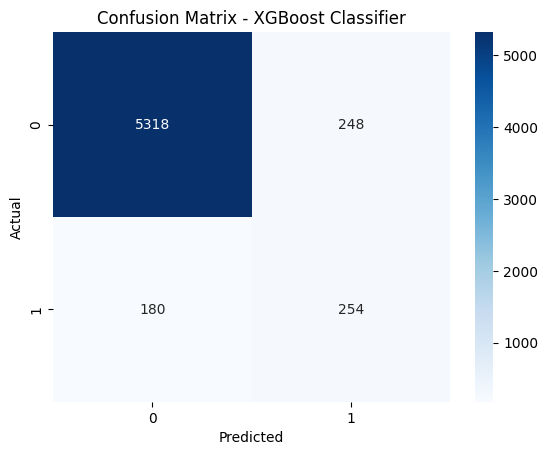

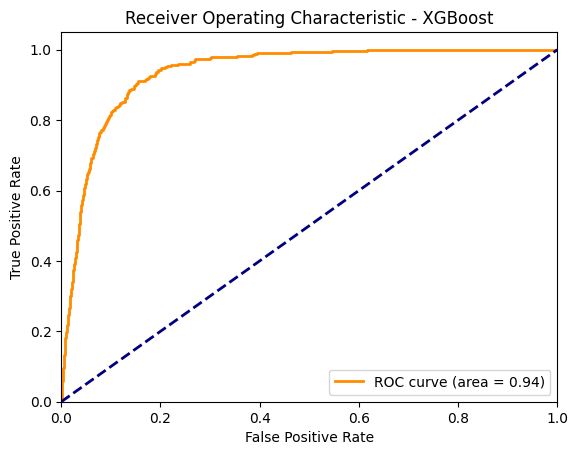

In [44]:
## train xgboost Classifier
model_xgb = xgb(n_estimators=300, random_state=42, scale_pos_weight=6,
                max_depth=6)
pipeline_xgb = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_xgb)])
### predict the test set results
pipeline_xgb.fit (X_train, y_train)
y_pred_xgb = pipeline_xgb.predict(X_test)
print("XGBoost Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_xgb))
print('Precision score', precision_score(y_test, y_pred_xgb))
print('Recall score', recall_score(y_test, y_pred_xgb))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_xgb))
print('classification report:\n', classification_report(y_test, y_pred_xgb))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_xgb), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - XGBoost Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_xgb = pipeline_xgb.predict_proba(X_test)[:, 1]
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_pred_proba_xgb)
roc_auc_xgb = auc(fpr_xgb, tpr_xgb)
plt.figure()
plt.plot(fpr_xgb, tpr_xgb, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_xgb)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - XGBoost')
plt.legend(loc="lower right")
plt.show()

### using lightgbm classifier


[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Number of positive: 2027, number of negative: 25973
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1150
[LightGBM] [Info] Number of data points in the train set: 28000, number of used features: 134
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.318920 -> initscore=-0.758741
[LightGBM] [Info] Start training from score -0.758741
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
LightGBM Classifier Results:
Accuracy score: 0.9173333333333333
Precision score 0.45481049562682213
Recall score 0.7188940092165899
Confusion Matrix:
 [[5192  374]
 [ 122  312]]
classification report:
               precision    recall  f1-score   support

           0       0.98      0.93      0.95      5566
           1       0.45      0.72      0.56       434

    accuracy                           0.92      6000
   macro avg       0.72      0.83      0.76      6000
weighted avg       0.94      0.92      0.93      6000



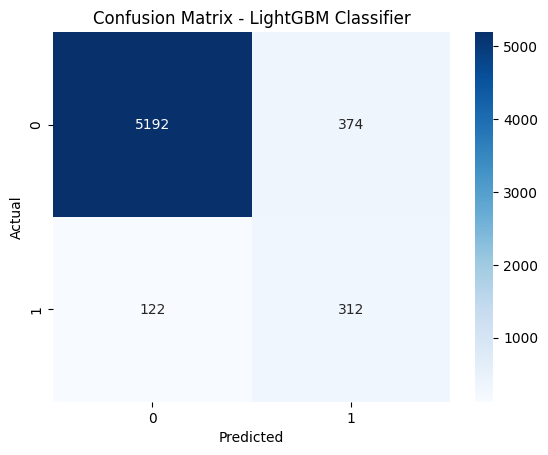

c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20


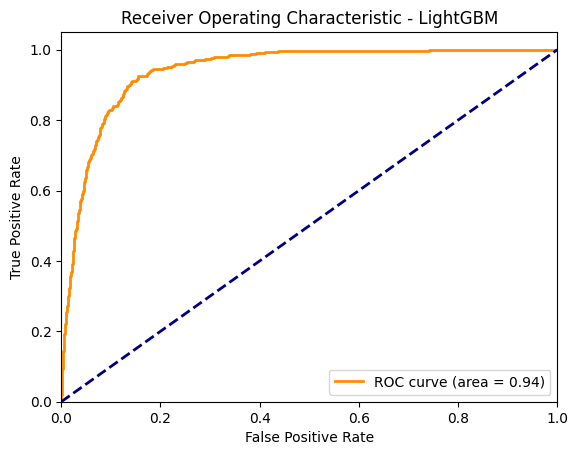

In [45]:
### using lightgbm classifier
import lightgbm as lgb
class_weight_dict = {0: 1.0, 1: 6}  # keeping class weight of no as 1.0
model_lgb = lgb.LGBMClassifier(n_estimators=300, random_state=42
, class_weight=class_weight_dict, max_depth=6, num_leaves=31, min_data_in_leaf=20, min_split_gain=0.0)
pipeline_lgb = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_lgb)])
### predict the test set results
pipeline_lgb.fit (X_train, y_train)
y_pred_lgb = pipeline_lgb.predict(X_test)
print("LightGBM Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_lgb))
print('Precision score', precision_score(y_test, y_pred_lgb))
print('Recall score', recall_score(y_test, y_pred_lgb))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_lgb))
print('classification report:\n', classification_report(y_test, y_pred_lgb))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lgb), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - LightGBM Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_lgb = pipeline_lgb.predict_proba(X_test)[:, 1]
fpr_lgb, tpr_lgb, _ = roc_curve(y_test, y_pred_proba_lgb)
roc_auc_lgb = auc(fpr_lgb, tpr_lgb)
plt.figure()
plt.plot(fpr_lgb, tpr_lgb, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_lgb)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - LightGBM')
plt.legend(loc="lower right")
plt.show()





In [46]:
len(input_features.columns)

25

### using decision tree classifier


Decision Tree Classifier Results:
Accuracy score: 0.9023333333333333
Precision score 0.40843373493975904
Recall score 0.7811059907834101
Confusion Matrix:
 [[5075  491]
 [  95  339]]
classification report:
               precision    recall  f1-score   support

           0       0.98      0.91      0.95      5566
           1       0.41      0.78      0.54       434

    accuracy                           0.90      6000
   macro avg       0.70      0.85      0.74      6000
weighted avg       0.94      0.90      0.92      6000



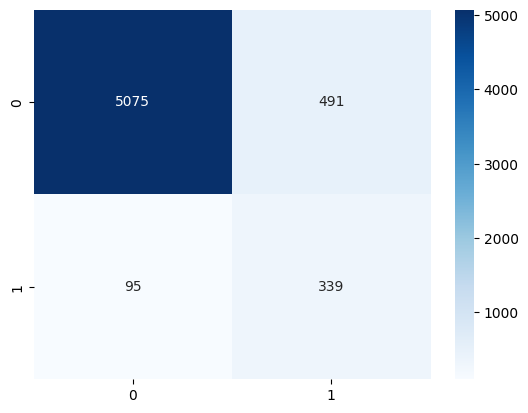

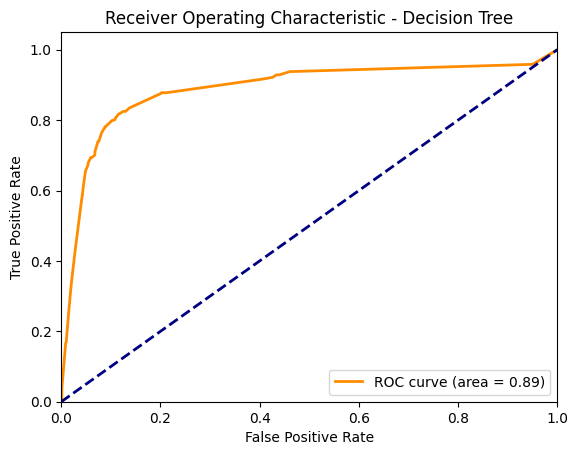

In [47]:
### using decision tree classifier
class_weight_dict = {0: 1.0, 1: 6}  # keeping class weight of no as 1.0
model_dt = DecisionTreeClassifier(random_state=42, class_weight=class_weight_dict,max_depth=8)
pipeline_dt = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_dt)])
pipeline_dt.fit(X_train, y_train)
y_pred_dt = pipeline_dt.predict(X_test)
print("Decision Tree Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_dt))
print('Precision score', precision_score(y_test, y_pred_dt))
print('Recall score', recall_score(y_test, y_pred_dt))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_dt))
print('classification report:\n', classification_report(y_test, y_pred_dt))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_dt), annot=True, fmt='d', cmap='Blues')
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_dt = pipeline_dt.predict_proba(X_test)[:, 1]
fpr_dt, tpr_dt, _ = roc_curve(y_test, y_pred_proba_dt)
roc_auc_dt = auc(fpr_dt, tpr_dt)
plt.figure()
plt.plot(fpr_dt, tpr_dt, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_dt)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Decision Tree')
plt.legend(loc="lower right")
plt.show()

### plotting using plotly AUC scores


In [54]:
## plotting using plotly AUC scores
# comparing different model performance
models = ['Logistic Regression', 'KNN', 'Random Forest', 'XGBoost', 'LightGBM', 'Decision Tree']
roc_auc = [roc_auc_lr,
             roc_auc_knn,
             roc_auc_rf,
             roc_auc_xgb,
             roc_auc_lgb,
             roc_auc_dt]
fig = px.bar(x=models, y=roc_auc, labels={'x':'Models', 'y':'AUC Scores'},
             title='Model Comparison - AUC Scores')
fig.show()
fig.write_image('../../reports/figures/model_comparison_auc_scores.png')

### feature selection using random forest


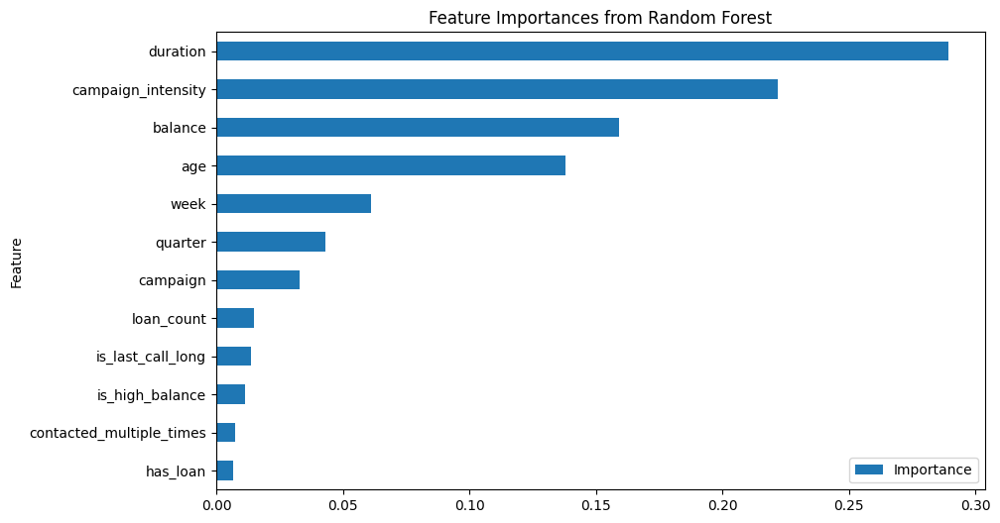

<Figure size 640x480 with 0 Axes>

In [ ]:
### feature selection using random forest
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(input_features.select_dtypes(include=[np.number]), target_variable)
importances = rf.feature_importances_
importances_df = pd.DataFrame({'Feature': input_features.select_dtypes(include=[np.number]).columns, 'Importance': importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)
importances_df.head(15).sort_values(by='Importance', ascending=True).plot(kind='barh', x='Feature', y='Importance', figsize=(10,6), title='Feature Importances from Random Forest')
plt.show()
##save feature importance plot
plt.savefig('../../reports/figures/feature_importances_random_forest.png')



### importance of top 6 features


In [ ]:
# importance of top 6 features
print(importances_df.head(6))


              Feature  Importance
2            duration    0.289395
8  campaign_intensity    0.221897
1             balance    0.159224
0                 age    0.138029
4                week    0.061306
5             quarter    0.043303


- duration of call, campain_intensity, balance , age of customer, month & week of month are some important features to focus on

### remove features with low importance


In [ ]:
### remove features with low importance
low_importance_features = importances_df[importances_df['Importance'] < 0.01]['Feature'].tolist()
print("Low importance features to be removed:", low_importance_features)

Low importance features to be removed: ['contacted_multiple_times', 'has_loan']


In [ ]:
input_features_reduced = input_features.drop(columns=low_importance_features)
input_features_reduced.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'week',
       'quarter', 'is_high_balance', 'loan_count', 'campaign_intensity',
       'is_last_call_long', 'age_group', 'education_job'],
      dtype='object')

In [ ]:
updated_numerical_features_2 = input_features_reduced.select_dtypes(include=[np.number]).columns.tolist()
updated_categorical_features_2 = input_features_reduced.select_dtypes(include=['object', 'category']).columns.tolist()

### preprocessing steps with updated features


In [ ]:

## preprocessing steps with updated features
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
binary_transformer = LabelEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, updated_numerical_features_2),
        ('cat', categorical_transformer, updated_categorical_features_2)
        #('bin', binary_transformer, binary_features)
    ]
)

### using lightgbm classifier


[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Number of positive: 2027, number of negative: 25973
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1129
[LightGBM] [Info] Number of data points in the train set: 28000, number of used features: 130
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.318920 -> initscore=-0.758741
[LightGBM] [Info] Start training from score -0.758741


c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
LightGBM Classifier Results:
Accuracy score: 0.9201666666666667
Precision score 0.46500777604976673
Recall score 0.6889400921658986
Confusion Matrix:
 [[5222  344]
 [ 135  299]]
classification report:
               precision    recall  f1-score   support

           0       0.97      0.94      0.96      5566
           1       0.47      0.69      0.56       434

    accuracy                           0.92      6000
   macro avg       0.72      0.81      0.76      6000
weighted avg       0.94      0.92      0.93      6000



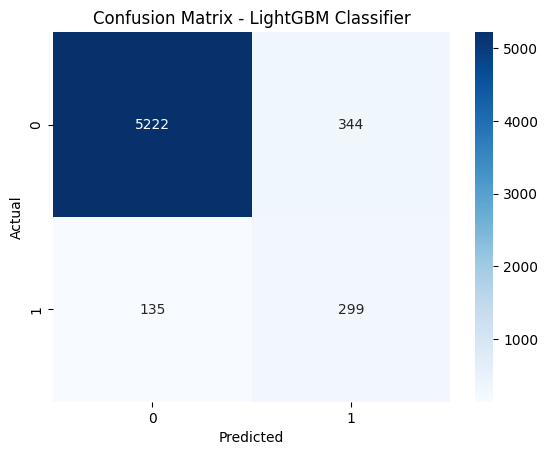

c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20


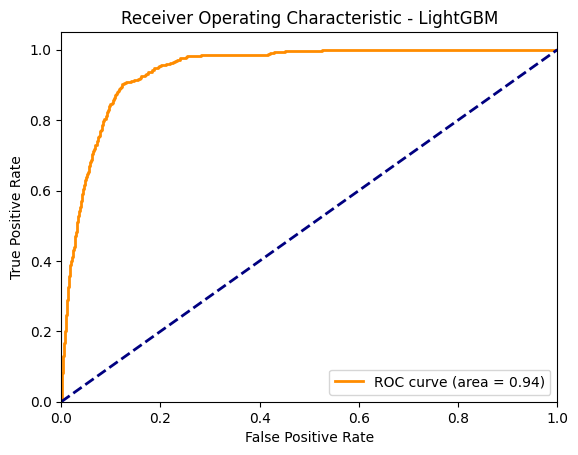

In [ ]:
### using lightgbm classifier
import lightgbm as lgb
class_weight_dict = {0: 1.0, 1: 6}  # keeping class weight of no as 1.0
model_lgb = lgb.LGBMClassifier(n_estimators=300, random_state=42
, class_weight=class_weight_dict, max_depth=-1, num_leaves=31, min_data_in_leaf=20, min_split_gain=0.0)
pipeline_lgb = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_lgb)])
### predict the test set results
pipeline_lgb.fit (X_train, y_train)
y_pred_lgb = pipeline_lgb.predict(X_test)
print("LightGBM Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_lgb))
print('Precision score', precision_score(y_test, y_pred_lgb))
print('Recall score', recall_score(y_test, y_pred_lgb))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_lgb))
print('classification report:\n', classification_report(y_test, y_pred_lgb))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lgb), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - LightGBM Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_lgb = pipeline_lgb.predict_proba(X_test)[:, 1]
fpr_lgb, tpr_lgb, _ = roc_curve(y_test, y_pred_proba_lgb)
roc_auc_lgb = auc(fpr_lgb, tpr_lgb)
plt.figure()
plt.plot(fpr_lgb, tpr_lgb, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_lgb)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - LightGBM')
plt.legend(loc="lower right")
plt.show()





#### apparently no improvement even with the removal of the low importance features

### performing clustering on the subscriber population and perform the analysis on the clusters to identify common characteristics. Performing a customer segmentation analysis

### loading the final dataset with subscribed customers only


In [223]:
### loading the final dataset with subscribed customers only
subscribed_customers= customer_df[customer_df['y']=='yes']
### saving to a file
subscribed_customers.to_csv('../../data/processed/subscribed_customers.csv', index=False)

### drop target variable for clustering


In [224]:
# drop target variable for clustering
subscribed_customers_features = subscribed_customers.drop('y', axis=1)

In [225]:
subscribed_customers.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'y'],
      dtype='object')

### feature engineering on subscribed customers dataset


In [226]:
## feature engineering on subscribed customers dataset
## day needs to be categorical
customer_df['day'] = customer_df['day'].astype('object')
# converting day to week
subscribed_customers_features['week'] = subscribed_customers_features['day'].apply(lambda x: (int(x)-1)//7 + 1)
subscribed_customers_features['balance_log'] = np.log1p(subscribed_customers_features['balance'] - subscribed_customers_features['balance'].min() + 1)

### converting month to quarter


In [227]:
# converting month to quarter
monthname = ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']

# normalize month values and map to quarter
subscribed_customers_features['month_norm'] = subscribed_customers_features['month'].astype(str).str.lower()

def month_to_quarter(m):
	try:
		return (monthname.index(m) // 3) + 1
	except ValueError:
		return np.nan

subscribed_customers_features['quarter'] = subscribed_customers_features['month_norm'].map(month_to_quarter).astype('Int64')
subscribed_customers_features.drop(columns=['month_norm'], inplace=True)
subscribed_customers_features['quarter'].value_counts(dropna=False)

quarter
2    1536
3     672
1     418
4     270
Name: count, dtype: Int64

### creating new features is_high_balance and loan_count


In [228]:
# creating new features is_high_balance and loan_count
is_high_balance = subscribed_customers_features['balance'] > subscribed_customers_features['balance'].median()
print(is_high_balance)
loan_count = subscribed_customers_features['housing'].map({'yes':1, 'no':0}) + subscribed_customers_features['loan'].map({'yes':1, 'no':0})
print(loan_count)

83        True
86       False
87        True
129       True
168      False
         ...  
39986     True
39988     True
39990     True
39996     True
39997    False
Name: balance, Length: 2896, dtype: bool
83       1
86       0
87       1
129      1
168      0
        ..
39986    1
39988    0
39990    1
39996    0
39997    0
Length: 2896, dtype: int64


### adding campaign features


In [229]:
## adding campaign features
subscribed_customers_features['campaign_intensity'] = subscribed_customers_features['duration'] / (subscribed_customers_features['campaign'] + 1)
contacted_multiple_times = subscribed_customers_features['campaign'] > 1
subscribed_customers_features['contacted_multiple_times'] = contacted_multiple_times.astype(int)
is_last_call_long = subscribed_customers_features['duration'] > subscribed_customers_features['duration'].median()
subscribed_customers_features['is_last_call_long'] = is_last_call_long.astype(int)

### adding age binning


In [230]:
## adding age binning
age_bins = [0, 18, 30, 40, 50, 60, 70, 80, 100]
age_labels = ['<18', '18-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+']
subscribed_customers_features['age_group'] = pd.cut(subscribed_customers_features['age'], bins=age_bins, labels=age_labels, right=False)

### adding all new features to subscribed_customers_features


In [231]:
### adding all new features to subscribed_customers_features
subscribed_customers_features['is_high_balance'] = is_high_balance.astype(int)
subscribed_customers_features['loan_count'] = loan_count
subscribed_customers_features['age_group'] = subscribed_customers_features['age_group']
subscribed_customers_features['week'] = subscribed_customers_features['week']
subscribed_customers_features['quarter'] = subscribed_customers_features['quarter']
subscribed_customers_features['campaign_intensity'] = subscribed_customers_features['campaign_intensity']
subscribed_customers_features['contacted_multiple_times'] = subscribed_customers_features['contacted_multiple_times']
subscribed_customers_features['is_last_call_long'] = subscribed_customers_features['is_last_call_long']
subscribed_customers_features['month_num'] = subscribed_customers_features['month'].map(month_map)
subscribed_customers_features['is_quarter_end'] = subscribed_customers_features['month_num'].isin([3,6,9,12]).astype(int)


In [232]:
subscribed_customers_features.describe()

,age,balance,duration,campaign,week,balance_log,quarter,campaign_intensity,contacted_multiple_times,is_last_call_long,is_high_balance,loan_count,month_num,is_quarter_end
count,2896.000000,2896.000000,2896.000000,2896.000000,2896.000000,2896.000000,2896.0,2896.000000,2896.000000,2896.000000,2896.000000,2896.000000,2896.000000,2896.000000
mean,39.844959,1588.495856,682.958564,2.414365,2.695787,8.342092,2.274171,239.396247,0.563536,0.499309,0.499655,0.636740,5.649171,0.145028
std,11.001984,2924.894429,431.287174,2.306015,1.259573,0.419144,0.821202,173.881517,0.496032,0.500086,0.500086,0.619167,2.369171,0.352189
min,19.000000,-3058.000000,8.000000,1.000000,1.000000,0.693147,1.0,4.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,31.000000,141.000000,364.000000,1.000000,2.000000,8.071219,2.0,110.000000,0.000000,0.000000,0.000000,0.000000,4.000000,0.000000
50%,37.000000,620.000000,629.000000,2.000000,3.000000,8.210668,2.0,203.000000,1.000000,0.000000,0.000000,1.000000,5.000000,0.000000
75%,47.000000,1820.500000,913.000000,3.000000,4.000000,8.493003,3.0,324.000000,1.000000,1.000000,1.000000,1.000000,7.000000,0.000000
max,95.000000,45248.000000,3881.000000,32.000000,5.000000,10.785352,4.0,1626.500000,1.000000,1.000000,1.000000,2.000000,12.000000,1.000000


### separating numerical and categorical features


In [233]:
## separating numerical and categorical features
numerical_features_subscribed = subscribed_customers_features.select_dtypes(include=[np.number]).columns.tolist()
categorical_features_subscribed = subscribed_customers_features.select_dtypes(include=['object', 'category']).columns.tolist()
print(numerical_features_subscribed)
print(categorical_features_subscribed)

['age', 'balance', 'duration', 'campaign', 'week', 'balance_log', 'quarter', 'campaign_intensity', 'contacted_multiple_times', 'is_last_call_long', 'is_high_balance', 'loan_count', 'month_num', 'is_quarter_end']
['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'day', 'month', 'age_group']


### scaling numerical features


In [234]:
## scaling numerical features
scaler = StandardScaler()
numerical_features_subscribed_scaled = scaler.fit_transform(subscribed_customers_features[numerical_features_subscribed])
numerical_features_subscribed_scaled_df = pd.DataFrame(numerical_features_subscribed_scaled, columns=numerical_features_subscribed)

### encoding categorical features


In [235]:
## encoding categorical features
encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
categorical_features_subscribed_encoded = encoder.fit_transform(subscribed_customers_features[categorical_features_subscribed])
categorical_feature_names = encoder.get_feature_names_out(categorical_features_subscribed)
categorical_features_subscribed_encoded_df = pd.DataFrame(categorical_features_subscribed_encoded, columns=categorical_feature_names)

### Code explanation


In [236]:
subscribed_customers_features_processed = pd.concat([numerical_features_subscribed_scaled_df.reset_index(drop=True), categorical_features_subscribed_encoded_df.reset_index(drop=True)], axis=1)

### k-means clustering


In [237]:
### k-means clustering

inertia = []
K = range(1, 30)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(subscribed_customers_features_processed)
    inertia.append(kmeans.inertia_)
# plot the elbow method
# plt.figure(figsize=(8, 5))
# plt.plot(K, inertia, 'bx-')
# plt.xlabel('Number of clusters (k)')
# plt.ylabel('Inertia')
# plt.title('Elbow Method For Optimal k')
# plt.show()
# ## saving elbow method plot
# plt.savefig('../../reports/figures/elbow_method_kmeans.png')
# plot using plotly
fig = px.line(x=K, y=inertia, title='Elbow Method For Optimal k', labels={'x':'Number of clusters (k)', 'y':'Inertia'})
fig.show()
fig.write_image('../../reports/figures/elbow_method_kmeans.png')
    

- K=5 seems optimal value. 

### find optimal number of clusters using silhouette score


In [238]:
## find optimal number of clusters using silhouette score
silhouette_scores = []

# transform features once to avoid repeated work
#X_clust = preprocessor.fit_transform(subscribed_customers_features)

for k in range(2, 15):
    kmeans = KMeans(n_clusters=k, random_state=42)
    cluster_labels = kmeans.fit_predict(subscribed_customers_features_processed)
    silhouette_avg = silhouette_score(subscribed_customers_features_processed, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    print(f"For n_clusters = {k}, the average silhouette_score is : {silhouette_avg}")

# plot silhouette scores
fig = px.line(x=list(range(2, 15)), y=silhouette_scores,
              title='Silhouette Scores For Different k',
              labels={'x':'Number of clusters (k)', 'y':'Silhouette Score'})
fig.show()
fig.write_image('../../reports/figures/silhouette_scores_kmeans.png')

For n_clusters = 2, the average silhouette_score is : 0.10823171707947563
For n_clusters = 3, the average silhouette_score is : 0.10738680467492354
For n_clusters = 4, the average silhouette_score is : 0.10547779130795676
For n_clusters = 5, the average silhouette_score is : 0.10836284909198292
For n_clusters = 6, the average silhouette_score is : 0.08952289460355872
For n_clusters = 7, the average silhouette_score is : 0.09523389436393732
For n_clusters = 8, the average silhouette_score is : 0.08751065733526606
For n_clusters = 9, the average silhouette_score is : 0.09176458193832175
For n_clusters = 10, the average silhouette_score is : 0.0849245163410614
For n_clusters = 11, the average silhouette_score is : 0.09124556547758704
For n_clusters = 12, the average silhouette_score is : 0.0866431291208026
For n_clusters = 13, the average silhouette_score is : 0.08784109084744468
For n_clusters = 14, the average silhouette_score is : 0.08964839844029247


- From silhouette graph, the optimal value is 5 as there is a steep drop after 5. 

### final kmeans with optimal clusters (say 5)


In [239]:
# final kmeans with optimal clusters (say 5)
kmeans_final = KMeans(n_clusters=5, random_state=42)
kmeans_final.fit(subscribed_customers_features_processed)
subscribed_customers_features_processed['cluster'] = kmeans_final.labels_
subscribed_customers_features_processed['cluster'].value_counts()

cluster
1    826
0    751
2    750
4    382
3    187
Name: count, dtype: int64

### cluster profiling


In [241]:
### cluster profiling
cluster_profiles = {}
for cluster in range(5):
    cluster_data = subscribed_customers_features_processed[subscribed_customers_features_processed['cluster'] == cluster]
    profile = {}
    for col in subscribed_customers_features_processed.columns:
        if col != 'cluster':
            if col in numerical_features_subscribed:
                profile[col] = cluster_data[col].mean()
            else:
                profile[col] = cluster_data[col].mode()[0]
    cluster_profiles[cluster] = profile
print(cluster_profiles)

{0: {'age': np.float64(0.12594457358445876), 'balance': np.float64(-0.17025980763179485), 'duration': np.float64(0.14391369843989832), 'campaign': np.float64(0.4457429261723847), 'week': np.float64(0.1802368872456395), 'balance_log': np.float64(-0.13140964092102395), 'quarter': np.float64(1.237556779375372), 'campaign_intensity': np.float64(-0.15610233053900155), 'contacted_multiple_times': np.float64(0.3457711106967448), 'is_last_call_long': np.float64(0.21842536523233333), 'is_high_balance': np.float64(-0.04857704699181663), 'loan_count': np.float64(-0.20690259663335753), 'month_num': np.float64(1.1874890234867468), 'is_quarter_end': np.float64(-0.40807827230393723), 'job_admin': np.float64(0.0), 'job_blue-collar': np.float64(0.0), 'job_entrepreneur': np.float64(0.0), 'job_housemaid': np.float64(0.0), 'job_management': np.float64(0.0), 'job_retired': np.float64(0.0), 'job_self-employed': np.float64(0.0), 'job_services': np.float64(0.0), 'job_student': np.float64(0.0), 'job_technician

### pretty print cluster profiles


In [ ]:
### pretty print cluster profiles
for cluster, profile in cluster_profiles.items():
    print(f"\nCluster {cluster} Profile:")
    for feature, value in profile.items():
        print(f"  {feature}: {value}")


Cluster 0 Profile:
  age: 0.12594457358445876
  balance: -0.17025980763179485
  duration: 0.14391369843989832
  campaign: 0.4457429261723847
  week: 0.1802368872456395
  balance_log: -0.13140964092102395
  quarter: 1.237556779375372
  campaign_intensity: -0.15610233053900155
  contacted_multiple_times: 0.3457711106967448
  is_last_call_long: 0.21842536523233333
  is_high_balance: -0.04857704699181663
  loan_count: -0.20690259663335753
  month_num: 1.1874890234867468
  is_quarter_end: -0.40807827230393723
  job_admin: 0.0
  job_blue-collar: 0.0
  job_entrepreneur: 0.0
  job_housemaid: 0.0
  job_management: 0.0
  job_retired: 0.0
  job_self-employed: 0.0
  job_services: 0.0
  job_student: 0.0
  job_technician: 0.0
  job_unemployed: 0.0
  job_unknown: 0.0
  marital_divorced: 0.0
  marital_married: 1.0
  marital_single: 0.0
  education_primary: 0.0
  education_secondary: 0.0
  education_tertiary: 0.0
  education_unknown: 0.0
  default_no: 1.0
  default_yes: 0.0
  housing_no: 1.0
  housing

### get_clusters function


In [ ]:
# get_clusters function
def get_clusters(k, data):
    model = KMeans(n_clusters=k, random_state=0)
    model.fit(data)
    predictions = model.predict(data)
    data["class"] = model.labels_
    return data

### creating clusters using the function created above


In [ ]:
get_clusters(5, subscribed_customers_features_processed)

,age,balance,duration,campaign,week,balance_log,quarter,campaign_intensity,contacted_multiple_times,is_last_call_long,...,month_oct,age_group_18-29,age_group_30-39,age_group_40-49,age_group_50-59,age_group_60-69,age_group_70-79,age_group_80+,cluster,class
0,1.741354,0.258004,0.832632,-0.613443,-1.346552,0.602802,-0.333924,1.619795,-1.136283,1.001382,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2,3
1,1.468629,-0.527801,1.818224,-0.613443,-1.346552,-0.719025,-0.333924,2.842102,-1.136283,1.001382,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2,3
2,0.105003,-0.108910,1.637339,-0.613443,-1.346552,0.074524,-0.333924,2.617773,-1.136283,1.001382,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2,3
3,1.377720,0.303484,-0.241084,-0.613443,-1.346552,0.660830,-0.333924,0.288199,-1.136283,-0.998620,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1,0
4,1.286812,-0.480270,-0.023094,-0.179720,-1.346552,-0.614524,-0.333924,-0.086642,0.880062,1.001382,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2891,-0.985898,-0.325366,-0.795335,-0.613443,-1.346552,-0.302609,-0.333924,-0.399170,-1.136283,-0.998620,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,4,1
2892,1.377720,0.271682,-0.213256,-0.179720,-1.346552,0.620403,-0.333924,-0.243865,0.880062,-0.998620,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,4,1
2893,-1.258623,-0.122246,-0.690978,-0.179720,-1.346552,0.052934,-0.333924,-0.638838,0.880062,-0.998620,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,4,1
2894,-0.894989,0.598930,-1.031877,0.254004,-1.346552,1.006894,-0.333924,-1.034770,0.880062,-0.998620,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4,1


### understanding feature distributions across clusters


In [247]:
### understanding feature distributions across clusters
for feature in numerical_features_subscribed:
    fig = px.histogram(subscribed_customers_features_processed, x=feature, color='cluster', barmode='group', title=f'{feature} Distribution across Clusters', marginal="box")
    fig.show()
    #fig.write_image(f'../../reports/figures/cluster_distribution_{feature}.png')

### decode categorical features for better interpretability


In [250]:
### decode categorical features for better interpretability
decoded_categorical_features = encoder.inverse_transform(subscribed_customers_features_processed[categorical_feature_names])
decoded_categorical_features_df = pd.DataFrame(decoded_categorical_features, columns=categorical_features_subscribed)
subscribed_customers_features_final = pd.concat([subscribed_customers_features_processed[numerical_features_subscribed].reset_index(drop=True), decoded_categorical_features_df.reset_index(drop=True), subscribed_customers_features_processed['cluster'].reset_index(drop=True)], axis=1)
subscribed_customers_features_final.head()


,age,balance,duration,campaign,week,balance_log,quarter,campaign_intensity,contacted_multiple_times,is_last_call_long,...,marital,education,default,housing,loan,contact,day,month,age_group,cluster
0,1.741354,0.258004,0.832632,-0.613443,-1.346552,0.602802,-0.333924,1.619795,-1.136283,1.001382,...,married,secondary,no,yes,no,unknown,5,may,50-59,2
1,1.468629,-0.527801,1.818224,-0.613443,-1.346552,-0.719025,-0.333924,2.842102,-1.136283,1.001382,...,married,secondary,no,no,no,unknown,5,may,50-59,2
2,0.105003,-0.108910,1.637339,-0.613443,-1.346552,0.074524,-0.333924,2.617773,-1.136283,1.001382,...,married,secondary,no,yes,no,unknown,5,may,40-49,2
3,1.377720,0.303484,-0.241084,-0.613443,-1.346552,0.660830,-0.333924,0.288199,-1.136283,-0.998620,...,married,secondary,no,yes,no,unknown,5,may,50-59,1
4,1.286812,-0.480270,-0.023094,-0.179720,-1.346552,-0.614524,-0.333924,-0.086642,0.880062,1.001382,...,married,tertiary,no,no,no,unknown,5,may,50-59,2


### addressing numerical features back to original scale for better interpretability


In [251]:
### addressing numerical features back to original scale for better interpretability
numerical_features_original_scale = scaler.inverse_transform(subscribed_customers_features_processed[numerical_features_subscribed])
numerical_features_original_scale_df = pd.DataFrame(numerical_features_original_scale, columns=numerical_features_subscribed)
subscribed_customers_features_final_original_scale = pd.concat([numerical_features_original_scale_df.reset_index(drop=True), decoded_categorical_features_df.reset_index(drop=True), subscribed_customers_features_processed['cluster'].reset_index(drop=True)], axis=1)
subscribed_customers_features_final_original_scale.head()

,age,balance,duration,campaign,week,balance_log,quarter,campaign_intensity,contacted_multiple_times,is_last_call_long,...,marital,education,default,housing,loan,contact,day,month,age_group,cluster
0,59.0,2343.0,1042.0,1.0,1.0,8.594710,2.0,521.000000,0.0,1.0,...,married,secondary,no,yes,no,unknown,5,may,50-59,2
1,56.0,45.0,1467.0,1.0,1.0,8.040769,2.0,733.500000,0.0,1.0,...,married,secondary,no,no,no,unknown,5,may,50-59,2
2,41.0,1270.0,1389.0,1.0,1.0,8.373323,2.0,694.500000,0.0,1.0,...,married,secondary,no,yes,no,unknown,5,may,40-49,2
3,55.0,2476.0,579.0,1.0,1.0,8.619027,2.0,289.500000,0.0,0.0,...,married,secondary,no,yes,no,unknown,5,may,50-59,1
4,54.0,184.0,673.0,2.0,1.0,8.084562,2.0,224.333333,1.0,1.0,...,married,tertiary,no,no,no,unknown,5,may,50-59,2


### understanding feature distributions across clusters


In [ ]:
### understanding feature distributions across clusters
for feature in numerical_features_subscribed:
    fig = px.histogram(subscribed_customers_features_final_original_scale, x=feature, color='cluster', barmode='group', title=f'{feature} Distribution across Clusters', marginal="box")
    fig.show()
    fig.write_image(f'../../reports/figures/cluster_distribution_{feature}.png')

## Final Cluster Summary

**Cluster Profiles Overview**
- **Cluster 0:** Senior affluent savers with high balances, low debt, and moderate campaign engagement.
- **Cluster 1:** Young professionals/students with moderate balances, mobile-first engagement, and early-career financial patterns.
- **Cluster 2:** Middle-aged homeowners with mortgages, higher call durations, and strong responsiveness after explanation.
- **Cluster 3:** Debt-free mid-career professionals with high balances, strong earning power, and excellent fit for premium products.
- **Cluster 4:** High-risk low-balance borrowers with defaults; require careful, risk-aware engagement.

**Key Features Influencing Segmentation**
- **Age & Age Group:** Distinguishes young, mid-age, and senior subscribers.
- **Balance & Balance Log:** Separates high-wealth from low-wealth customers.
- **Loan Count:** Highlights indebted vs non-indebted groups.
- **Campaign Count:** Identifies quick converters vs multi-touch responders.
- **Call Duration:** Helps detect highly engaged customers.
- **Contact Type:** Mobile-first vs mixed-channel preferences.
- **Month of Contact:** Captures seasonal subscription patterns.

This summary provides a complete overview of the clusters and their key differentiating features.

## 📌 Executive Business Summary

### 🎯 Objective
The goal of this customer segmentation exercise was to **understand the profiles of term-deposit subscribers** and to identify **actionable customer segments** that drive greater marketing efficiency, personalization, and revenue growth.

---

## 🧩 Key Findings from Clustering (k = 5)
Our clustering analysis revealed **five distinct and meaningful customer segments** within the subscriber base. Each cluster represents different behavioral, demographic, and financial characteristics useful for targeted marketing strategies.

### **Cluster 0 – Senior Affluent Savers**
- Older, financially stable individuals (mostly 50+)
- High balances and low debt
- Moderate engagement required to subscribe
- **Business Insight:** Highly valuable, low-risk customers ideal for premium, long-term fixed deposits.

### **Cluster 1 – Young Connected Starters**
- Younger subscribers (<30), digitally engaged
- Moderate balances and moderate debt levels
- Prefer mobile-first communication
- **Business Insight:** Good prospects for introductory-term deposit offerings and mobile-only campaigns.

### **Cluster 2 – Middle-Aged Indebted Homeowners**
- Primarily 30–50-year-olds with active housing loans
- Longer call durations—require more explanation and reassurance
- **Business Insight:** Strong cross-sell opportunity with mortgage-related savings products and stability-focused messaging.

### **Cluster 3 – Debt-Free Mid-Career Professionals**
- Mid-aged, strongly employed (management, technical roles)
- High balances and little to no debt
- **Business Insight:** Ideal for **high-value**, high-yield products, and cross-selling structured investment solutions.

### **Cluster 4 – High-Risk Low-Balance Borrowers**
- Small, financially stressed segment
- Lowest balances and highest loan burdens; many flagged for default

- **Business Insight:** Avoid prioritizing for aggressive marketing; best suited for risk-managed, low-minimum deposit offers or financial rehabilitation programs.

---

## 🚀 Business Recommendations

### 1️⃣ Prioritize Revenue-Generating Segments
- **Clusters 0 and 3** offer the strongest potential for high-value term deposits.
- Focus campaigns and relationship management resources here.

### 2️⃣ Create Tailored Marketing Journeys
- **Cluster 1 (Young)** → Mobile apps, SMS campaigns, smaller deposits, starter packs
- **Cluster 2 (Homeowners)** → Cross-sell with mortgage support, emphasize safety and steady returns
- **Cluster 4** → Low-risk, low-barrier products; avoid credit stress

### 3️⃣ Improve Contact Strategy
- Long-duration conversations correlate with conversions
- Optimize scripts for **Cluster 2** who require explanation
- Use shorter, more direct scripts for **Cluster 1**

### 4️⃣ Enhance Predictive Models
- Use engineered features (balance_log, loan_count, call duration) to refine subscriber propensity models
- Combine clustering insights with classification models for even higher accuracy

---

## 📈 Conclusion
This segmentation exercise demonstrates that the term-deposit subscriber population is **highly diverse**, and substantial efficiency gains can be achieved through targeted, personalized marketing. By aligning product offerings and communication styles to each cluster’s financial and behavioral traits, the bank can increase subscription rates, reduce marketing costs, and enhance customer satisfaction.